In [1]:
import plotly.graph_objs as go
import pandas as pd
import numpy as np
import json
import plotly.express as px

In [2]:
df_985211 = pd.read_csv("985&211.csv")

In [3]:
beijing2019 = pd.read_csv("beijing2019.csv")
df_region = pd.read_csv("14-19年各省高考分数线.csv")
df_university = pd.read_csv("高考分数线.csv",index_col = 0)
df_985211 = pd.read_csv("985&211.csv")
with open(r'/Users/patrickyip/plotly-/china.json',encoding='utf-8')as f:
    china_geo=json.load(f)

In [4]:
l = []
for i in china_geo['features']:
    l.append((i['id'],i['properties']['name']))
    
df_fips = pd.DataFrame(l,columns=['FIPS',"省份"])
df_uni = pd.merge(df_university,df_985211,left_on = "学校名称",right_on = 'uni',how = "left")
uni_location=df_uni.drop_duplicates(subset = "学校名称").groupby("省份").agg(学校数量=('学校名称','count')).reset_index()
uni_location = uni_location.merge(df_fips,on= '省份')

## 各省高考资源分布

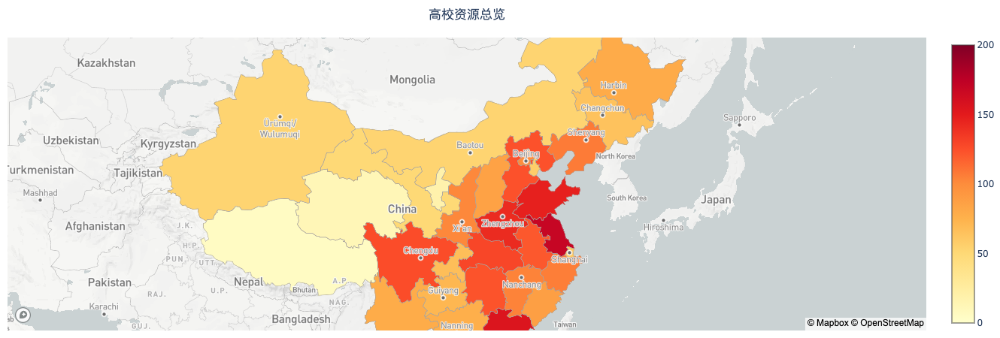

In [5]:
token='pk.eyJ1Ijoic3l2aW5jZSIsImEiOiJjazZrNTcwY3kwMHBrM2txaGJqZWEzNWExIn0.tLQHY_OoiR2NMxnYHXUBAA'

fig=go.Figure(go.Choroplethmapbox(geojson=china_geo,locations=uni_location['FIPS'],z=uni_location['学校数量'],
                                  hovertext=uni_location['省份'],hoverinfo='text+z',zmax=200,zmin=0,text=uni_location['省份'], 
                                  colorscale='YlOrRd',marker_line_width=0.5,marker_line_color='rgb(169,164,159)'))
fig.update_layout(mapbox={'accesstoken':token,'center':{'lon':109.469607,'lat':37.826077},'zoom':3},
                 title={'text':'高校资源总览','xref':'paper','x':0.5},
                 margin={'l':10,'r':0,'t':50,'b':10})
fig.show()

In [6]:
df_985 = df_uni.loc[~df_uni['985'].isnull(),:].drop_duplicates(subset = "学校名称") #985
df_211 = df_uni.loc[~df_uni['211'].isnull(),:].drop_duplicates(subset = "学校名称") #211
df_benyi = df_uni.loc[df_uni['录取批次'] == '本科一批',:].drop_duplicates(subset = "学校名称") #本科一批
df_total_uni = df_uni.drop_duplicates(subset = '学校名称').groupby("省份").agg(num_of_uni = ("学校名称","count")).reset_index()

In [7]:
df_985 = df_985.groupby("省份").agg(num_of_uni = ("学校名称","count")).reset_index()
df_211 = df_211.groupby("省份").agg(num_of_uni = ("学校名称","count")).reset_index()
df_benyi = df_benyi.groupby("省份").agg(num_of_uni = ("学校名称","count")).reset_index()

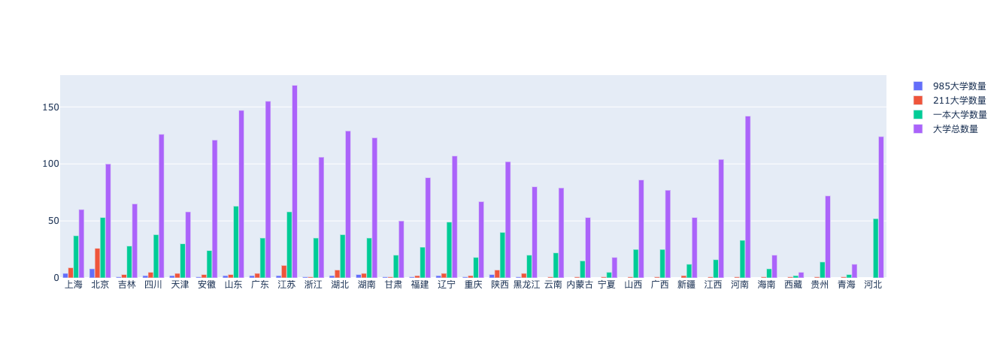

In [8]:
fig = go.Figure()

fig.add_trace(go.Bar(
    x=df_985['省份'],
    y=df_985['num_of_uni'],
    name= "985大学数量"
))
fig.add_trace(go.Bar(
    x=df_211['省份'],
    y=df_211['num_of_uni'],
    name= "211大学数量"
))
fig.add_trace(go.Bar(
    x=df_benyi['省份'],
    y=df_benyi['num_of_uni'],
    name= "一本大学数量"
))
fig.add_trace(go.Bar(
    x=df_total_uni['省份'],
    y=df_total_uni['num_of_uni'],
    name= "大学总数量"
))

fig.show()

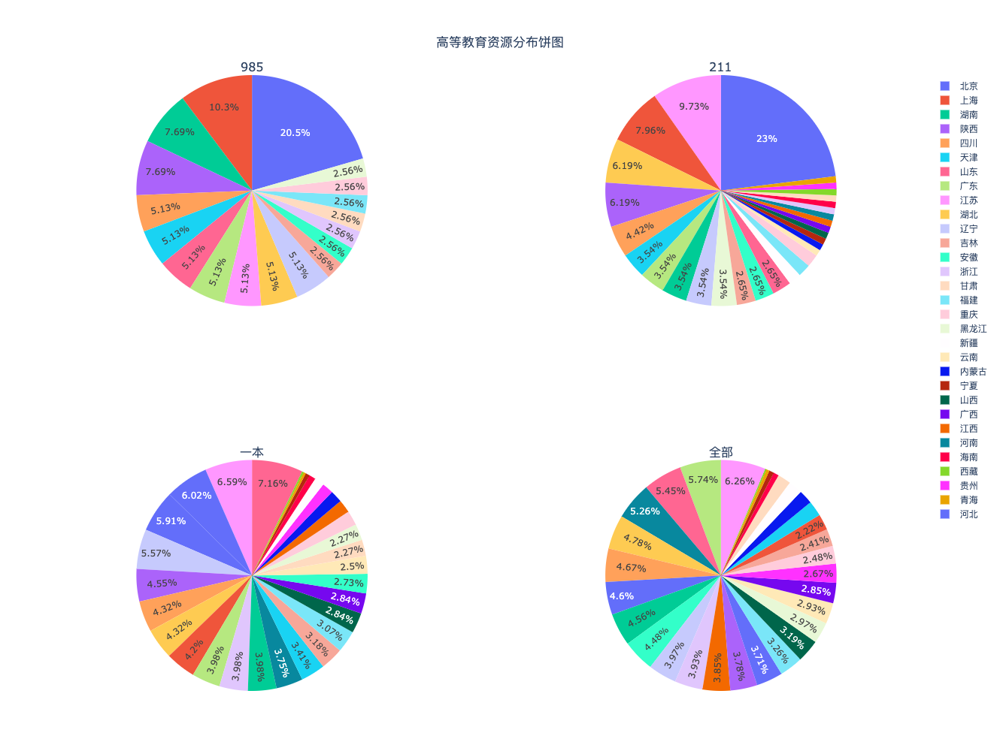

In [9]:
from plotly.subplots import make_subplots

fig = make_subplots(
    rows=2, 
    cols=2,
    specs = [[{"type": "domain"}, {"type": "domain"}],
           [{"type": "domain"}, {"type": "domain"}]],
    
    subplot_titles = ['985','211','一本','全部']

)

fig.add_trace(
    go.Pie(
        labels = df_985['省份'],
        values = df_985['num_of_uni']
    ),
    row = 1,
    col = 1
)

fig.add_trace(
    go.Pie(
        labels = df_211['省份'],
        values = df_211['num_of_uni']
    ),
    row = 1,
    col = 2
)
fig.add_trace(
    go.Pie(
        labels = df_benyi['省份'],
        values = df_benyi['num_of_uni']
    ),
    row = 2,
    col = 1
)
fig.add_trace(
    go.Pie(
        labels = df_total_uni['省份'],
        values = df_total_uni['num_of_uni']
    ),
    row = 2,
    col = 2
)
fig.update_traces(textposition='inside')
fig.update_layout(
    height=1000,
    uniformtext_minsize=12, 
    uniformtext_mode='hide',
    title = {
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'text' : "高等教育资源分布饼图"
    }
)

### 结论
总体来看，我国的高校资源分布极其不平衡，主要是由以下维度的不平衡：
* 各省高校数量差距较大。此次统计中，江苏省高校数量最多，有169所，其次为广东，155所；然而在西藏的高校总数仅为5所，青海和宁夏也分别只有不到20所。
* 各省985大学数量悬殊，39所985大学中，北京就占了8所之多，而一些自治区以及欠发达省份没有985大学。

一句话总结大概就是，越是高等的教育资源分配就越不均匀，这种不均匀主要体现在欠发达地区和自治区与其他省份的差距。

## 高校分布

## 各省份本科一批分数线情况

因为各省份的考题有区别，因此对比各省份之前的分数意义不是很大，这里主要考察各省份各年份之间的本科一批分数线变化情况以及文理科之间的差距

### 各省份文理科本科一批分数线变化情况

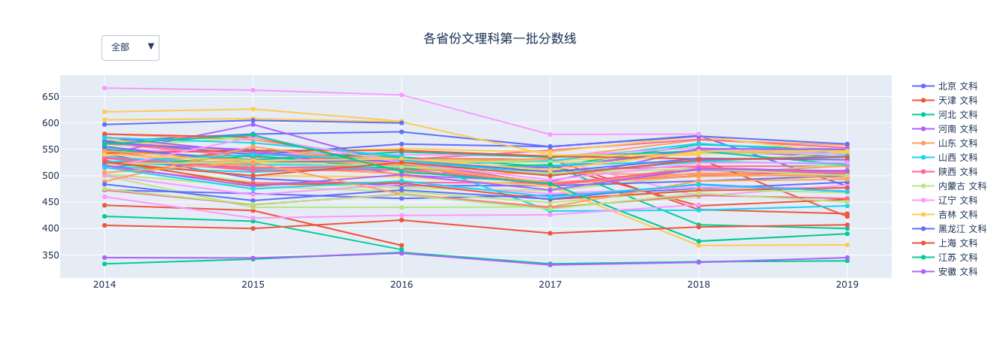

In [10]:
fig = go.Figure()

region_list1 = df_region['地区'].unique()
region_science = [i+ " 理科" for i in region_list1]
region_art = [i+ " 文科" for i in region_list1]

region_list = np.vstack((region_science,region_art)).reshape(-1)

button_list = []


for subject in ['文科','理科']:
    for i,val in enumerate(region_list1):
       
           
        v = val + " "+ subject
        

        
        df = df_region.query(f"地区 == '{val}' & 考生类别 == '{subject}' & (批次 == '本科一批' | 批次 == '本科批') ")
        
        fig.add_trace(
            go.Scatter 
            (

                x=df["年份"],
                y=df['分数线'],
                mode='lines+markers',
                name= v

            )
        )
        



        if subject =='文科':
        
            arr = [True if val in region else False for region in region_list]
            
            button_list.append( 

                dict(
                    args = [{'visible':list(arr)}],
                    label = f'{val}',
                    method = "restyle"
                )
                

            )
 
    
button_list.insert(
    
    0,
    dict(
        args = [{'visible':np.where(region_list=="",False,True)}],
        label = '全部',
        method = "restyle"
    )

)
    
fig.update_layout(
    updatemenus=[
        dict(
            buttons=list(
                button_list
            ),
            direction="down",
            pad={"r": 0, "t": 0},
            showactive=True,
            x=0.05,
            xanchor="left",
            y=1.2,
            yanchor="top"
        ),
    ],
    title = {
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'text' : "各省份文理科第一批分数线"
    }
    
)


fig.show()

分数线的变化没有特定的趋势，一般都是视考卷难度而定的。

鉴于我是广东省2014年的高考生，因此我重点看了广东的考分数情况。

14-15年广东省使用的是广东卷，而到了2016年的时候转成了全国卷，难度有所提高，因此，文理科的分数线都有比较大幅度的下降

而在2018的时候，不再设立本科一批线的了，只有本科线这一说法，因此分数线再次出现大幅度下降。

而通过抽取一些省份进行观察，能够发现文科分数线普遍来说是比理科的分数线高的，但总体情况是否真的这样呢，我们可以验证一下


In [11]:
df_ = df_region.merge(df_region,on=['地区','年份',"批次"],suffixes = ("","_")).query("(批次 =='本科一批' | 批次 =='本科批') & 考生类别 == '理科' & 考生类别_ != '理科'")

In [12]:
df_["文科理科分数线差"] = df_['分数线_'] - df_['分数线']

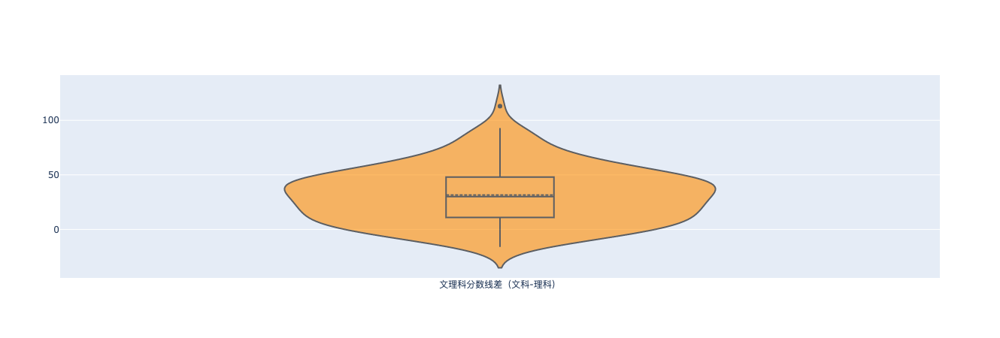

In [13]:
fig = go.Figure(
    data=go.Violin(
        y=df_['文科理科分数线差'],
        box_visible=True, 
        line_color='black',
        meanline_visible=True, 
        fillcolor='DarkOrange', 
        opacity=0.6,
        x0='文理科分数线差（文科-理科）'
    )
)

fig.update_layout(yaxis_zeroline=False)
fig.show()

可以清晰看到文科的分数线大部分情况下还是高于理科的，并且有超过差异多数在50分以下，中位数为30，平均数也是30左右，最大值为113，最小值为-16，分数线的差距分布是一个稍长尾的分布

## 上985，211和重点本科分别是什么水平？

1. 上985真的那么NB吗，如果要上最差的985大概是什么水平呢？

2. 同理，上211大概代表了什么水平？

3. 到底是文科容易上好学校还是理科呢？

4. 不同省份之间大概有什么样的差异

接下来，使用两个方法来考察这些问题：

1. 分别计算出每一年在各省份考上985和211的分数比一本线多出的百分比

2. 以2018年北京,河北,广东和广西这四个地区的高考分数为例分析这几个问题，至于为什么找这四个地区呢，纯粹是因为我找了一圈发现这几个省份的数据比较好整理

In [45]:
def format_data(df):
    split_score = int(input("分割分数"))
    
    _ = df.query("score >@split_score")
    __ = df.query("score <=@split_score")
    
    _ = _.groupby(_["score"]//10).agg(number = ("number","sum")).reset_index()
    _["score"] = _["score"] * 10

    return pd.concat([_,__],ignore_index = True).sort_values(by = "score").reset_index(drop = True).fillna(0)

def ungrouping(df, cnt):
    df = df.copy(deep=True)
    df = df.loc[np.repeat(df.index.values,df[cnt])
               ].reset_index(drop=True)
    df[cnt] = 1
    return df


def process_score(string):
    try:
        
        score = np.floor(float(string))
        
    except:
        
        score = np.nan
    
    return score

def process_gaokao_data(province,year):
    path = f"./{province}{year}.csv"
    
    df = pd.read_csv(path)
    
    df_art = df.loc[:,["score","number_art"]].copy().rename(columns = {"number_art":"number"})
    df_science = df.loc[:,["score","number_science"]].copy().rename(columns = {"number_science":"number"})
    df_art = ungrouping(format_data(df_art).fillna(0),"number")
    df_science = ungrouping(format_data(df_science).fillna(0),"number")
    return df_science,df_art


def cal_percentage_over_line(province,year,df1,df):
    
    data = []
    line_art = df1.query(f"批次 == '本科一批' & 地区 =='{province}' & 年份 =={year} & 考生类别 =='文科'")["分数线"]
    line_science = df1.query(f"批次 == '本科一批' & 地区 =='{province}' & 年份 =={year} & 考生类别 =='理科'")["分数线"]





    if line_art.shape[0] >0:
        
        line_art = line_art.values[0]
        min_985_art = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & 录取批次 =='本科一批' & 最低分 != -1 & 最低分 >=@line_art & 考生类别 == '文科'")["最低分"].min()
        min_211_art = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & 录取批次 =='本科一批' & 最低分 != -1 & 最低分 >=@line_art & 考生类别 == '文科'")["最低分"].min()
        
        percentage_art_985 = min_985_art/line_art - 1
        percentage_art_211 = min_211_art/line_art - 1

        data.append(
            {
                "地区":province,
                "分数线":line_art,
                "考生类别":"文科",
                "年份":year,
                "985分数超出百分比":percentage_art_985*100,
                "211分数超出百分比":percentage_art_211*100
            }
        )
        
    if line_science.shape[0] >0:
        
        
        line_science = line_science.values[0]
        min_985_science = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & 录取批次 =='本科一批' & 最低分 != -1 & 最低分 >=@line_science & 考生类别 == '理科'")["最低分"].min()
        min_211_science = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & 录取批次 =='本科一批' & 最低分 != -1 & 最低分 >=@line_science & 考生类别 == '理科'")["最低分"].min()
        
        percentage_science_985 = min_985_science/line_science - 1
        percentage_science_211 = min_211_science/line_science - 1
        
        data.append(
            {
                "地区":province,
                "分数线":line_science,
                "考生类别":"理科",
                "年份":year,
                "985分数超出百分比":percentage_science_985*100,
                "211分数超出百分比":percentage_science_211*100
            }
        )
    return pd.DataFrame(data)
def cal_percentile(df,province,year,df_art,df_science):
    
    
    min_985_science = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")["最低分"].min()
    min_211_science = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")["最低分"].min()
    min_985_art = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '文科'")["最低分"].min()
    min_211_art = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '文科'")["最低分"].min()
    
    min_QB_art = df_uni.query(f"学校名称 in ['清华大学','北京大学'] & (录取批次 =='本科一批'| 录取批次 =='本科批') & 招生类型 =='普通类' & 最低分 !=-1 & 招生地址 =='{province}' & 年份 == {year} & 考生类别 == '文科'")["最低分"].min()
    min_QB_science = df_uni.query(f"学校名称 in ['清华大学','北京大学'] & (录取批次 =='本科一批'| 录取批次 =='本科批') & 招生类型 =='普通类' & 最低分 !=-1 & 招生地址 =='{province}' & 年份 == {year} & 考生类别 == '理科'")["最低分"].min()
 
    print(f"{province}{year}年情况如下")
    print("理科情况如下")
    print("985的分数大概在前{:.2f}%".format(df_science.query("score>=@min_985_science").shape[0]/df_science.shape[0]*100))
    print("211的分数大概在前{:.2f}%".format(df_science.query("score>=@min_211_science").shape[0]/df_science.shape[0]*100))
    print("考上清北的分数大概在前{:.4f}%".format(df_science.query("score>=@min_QB_science").shape[0]/df_science.shape[0]*100))
#     print("理科一批的分数大概在前{:.2f}%".format(df_science.query("score>=532").shape[0]/df_science.shape[0]*100))
    print("文科情况如下")
    print("985的分数大概在前{:.2f}%".format(df_art.query("score>=@min_985_art").shape[0]/df_art.shape[0]*100))
    print("211的分数大概在前{:.2f}%".format(df_art.query("score>=@min_211_art").shape[0]/df_art.shape[0]*100))
    print("考上清北的分数大概在前{:.4f}%".format(df_science.query("score>=@min_QB_art").shape[0]/df_art.shape[0]*100))

#     print("本科一批的分数大概在前{:.2f}%".format(df_art.query("score>=576").shape[0]/df_art.shape[0]*100))


    


def box_plot_data(df,province,year,df_science,df_art):
    total_science = df_science.shape[0]
    total_art = df_art.shape[0]
    def cal_percentile_art(score,df_art,total_art):
        return df_science.query("score >=@score").shape[0]/total_art
        
    def cal_percentile_science(score,df_science,total_science):
        
        return df_science.query("score >=@score").shape[0]/total_science
    
    
    science_985 = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")
    science_211 = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")
    
    art_985 = df[df["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '文科'")
    art_211 = df[df["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '{province}' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '文科'")

    percent_985_science = science_985["最低分"].apply(cal_percentile_science,args = (df_science,total_science))
    
    percent_985_art = art_985["最低分"].apply(cal_percentile_art,args = (df_art,total_art))
    
    percent_211_science = science_211["最低分"].apply(cal_percentile_science,args = (df_science,total_science))
    
    percent_211_art = art_211["最低分"].apply(cal_percentile_art,args = (df_art,total_art))
    
    
    out = {
        
        province:{
            
            "文科":{
                "985":percent_985_art.values.tolist(),
                "211":percent_211_art.values.tolist()

            },
            "理科":{

                "985":percent_985_science.values.tolist(),
                "211":percent_211_science.values.tolist()

            }
            
                
        }
    }
    
    return out

In [44]:
{"a":{"b":[12,3],"c":[123]}}

{'a': {'b': [12, 3], 'c': [123]}}

In [248]:
df_uni[df_uni["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '广东' & 年份 == 2018 & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '文科'")["最低分"]

197375    625
197447    610
197718    579
197913    581
198042    575
         ... 
278240    612
278329    601
278428    606
278742    580
281792    575
Name: 最低分, Length: 75, dtype: object

In [16]:
df_uni["最低分"] = df_uni["最低分"].apply(process_score)
df_list = []
for province in df_region["地区"].unique():
    for year in [2014,2015,2016,2017,2018]:
        df_list.append(cal_percentage_over_line(province,year,df_region,df_uni))
df_all = pd.concat(df_list,ignore_index = True).dropna()


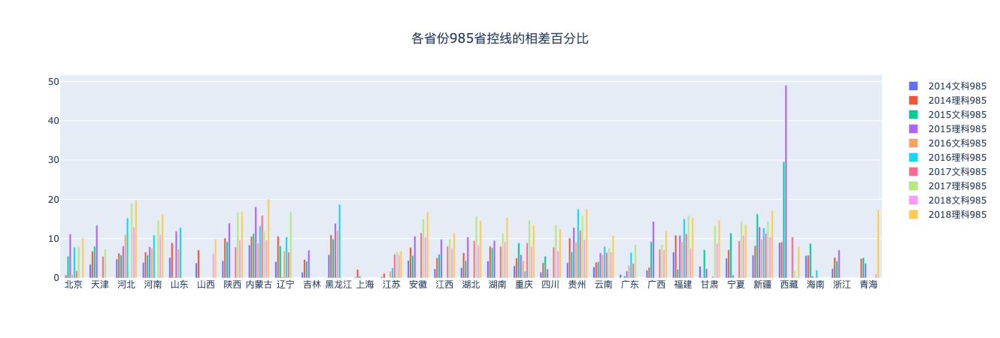

In [17]:
fig = go.Figure()

    
for i,year in enumerate([2014,2015,2016,2017,2018]):

    for subject in ["文科","理科"]:


        v = province + str(year) + "_" + subject


        _ = df_all.query(f"年份 =={year} & 考生类别 =='{subject}'")

        fig.add_trace(

            go.Bar(
                x =_["地区"],
                y =_["985分数超出百分比"],
                name = str(year) + subject + "985"

            )
        )

    
fig.update_layout(

    title = {
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'text' : "各省份985省控线的相差百分比"
    }
    
)


fig.show()

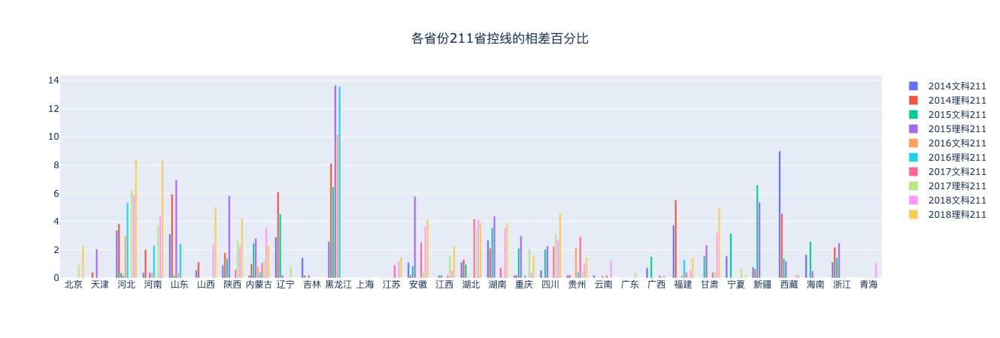

In [18]:
fig = go.Figure()

    
for i,year in enumerate([2014,2015,2016,2017,2018]):

    for subject in ["文科","理科"]:


        v = province + str(year) + "_" + subject


        _ = df_all.query(f"年份 =={year} & 考生类别 =='{subject}'")

        fig.add_trace(

            go.Bar(
                x =_["地区"],
                y =_["211分数超出百分比"],
                name = str(year) + subject + "211"

            )
        )


    
fig.update_layout(

    title = {
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'text' : "各省份211省控线的相差百分比"
    }
    
)


fig.show()

这两个图其实没有给出太多的信息，但是我们隐约可以看到在有些年份，西藏在有些年份考上985似乎特别难,在黑龙江考上211也比较难，而在上海和江苏，似乎不需要超出很多就能上985和211。


如果我们选定2015的数据来看，江苏，上海和广东考上985和211似乎都比较容易，然而在西藏考上985却很难，在黑龙江考上211也很难。

但是，如果单纯以分数差来衡量难度，而不考虑考生成绩分布的话，结果意义不是很大，于是，下面我会以四个地区的成绩分布来换个角度分析这些问题。

In [19]:
year = 2018
for province in ["beijing","guangdong","hebei","guangxi"]:
    
    locals()[province + str(year) + "_science"],locals()[province + str(year) + "_art"] = process_gaokao_data(province,year)

分割分数 420
分割分数 420
分割分数 0
分割分数 0
分割分数 0
分割分数 0
分割分数 0
分割分数 0


In [128]:
df_uni.query(f"学校名称 in ['清华大学','北京大学'] & 最低分 !=-1 & 招生地址 =='广东' & 年份 == 2018 & 考生类别 == '文科'")

,学校名称,平均分,年份,录取批次,招生地址,招生类型,最低分,省份,省控线,考生类别,uni,985,211
220417,北京大学,-,2018,本科批,广东,普通类,679.0,北京,443,文科,北京大学,Y,Y
220592,清华大学,-,2018,本科批,广东,普通类,666.0,北京,443,文科,清华大学,Y,Y


首先我们大致看一下2018年四个地区的文理科的分数分布情况大概是怎样的

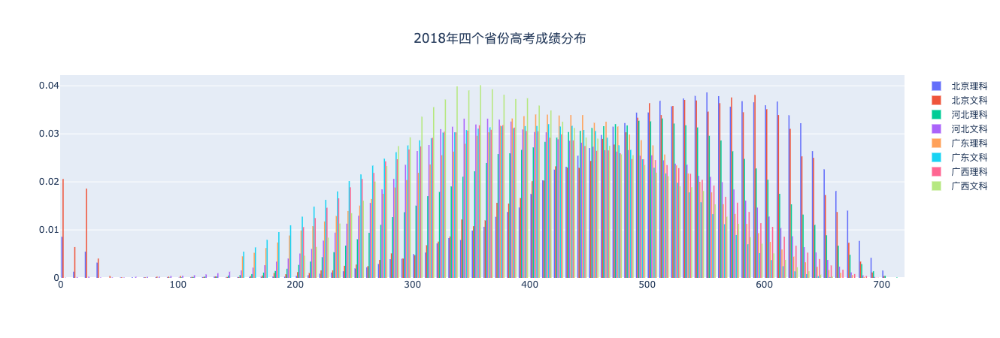

In [20]:
fig = go.Figure()
fig.add_trace(
    go.Histogram(
        x=beijing2018_science['score'],
        name = "北京理科",
        histnorm='probability'

    
    )
)

fig.add_trace(
    go.Histogram(
        x=beijing2018_art['score'],
        name = "北京文科",
        histnorm='probability'
    
    )
)

fig.add_trace(
    go.Histogram(
        x=hebei2018_science['score'],
        name = "河北理科",
        histnorm='probability'

    
    )
)

fig.add_trace(
    go.Histogram(
        x=hebei2018_art['score'],
        name = "河北文科",
        histnorm='probability'
    
    )
)

fig.add_trace(
    go.Histogram(
        x=guangdong2018_science['score'],
        name = "广东理科",
        histnorm='probability'

    
    )
)

fig.add_trace(
    go.Histogram(
        x=guangdong2018_art['score'],
        name = "广东文科",
        histnorm='probability'
    
    )
)

fig.add_trace(
    go.Histogram(
        x=guangxi2018_science['score'],
        name = "广西理科",
        histnorm='probability'

    
    )
)

fig.add_trace(
    go.Histogram(
        x=guangxi2018_art['score'],
        name = "广西文科",
        histnorm='probability'
    
    )
)



fig.update_layout(

    title = {
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'text' : "2018年四个省份高考成绩分布"
    }

)

fig.show()

In [46]:
province_dict = {
    "beijing":"北京",
    "hebei":"河北",
    "guangxi": "广西",
    "guangdong":"广东"
}
year = 2018
dict_list = []
for province in ["beijing","guangdong","hebei","guangxi"]:
    df_art = locals()[province + str(year) + "_art"]
    df_science = locals()[province + str(year) + "_science"]
    cal_percentile(df_uni,province_dict[province],year,df_art,df_science)
    print("*"*50)
    dict_list.append(box_plot_data(df_uni,province_dict[province],year,df_science,df_art))


北京2018年情况如下
理科情况如下
985的分数大概在前26.97%
211的分数大概在前41.86%
考上清北的分数大概在前0.5694%
文科情况如下
985的分数大概在前26.61%
211的分数大概在前26.61%
考上清北的分数大概在前2.9452%
**************************************************
广东2018年情况如下
理科情况如下
985的分数大概在前7.61%
211的分数大概在前36.72%
考上清北的分数大概在前0.1883%
文科情况如下
985的分数大概在前2.09%
211的分数大概在前7.00%
考上清北的分数大概在前0.0862%
**************************************************
河北2018年情况如下
理科情况如下
985的分数大概在前6.47%
211的分数大概在前20.51%
考上清北的分数大概在前0.0102%
文科情况如下
985的分数大概在前1.33%
211的分数大概在前5.14%
考上清北的分数大概在前0.0853%
**************************************************
广西2018年情况如下
理科情况如下
985的分数大概在前6.57%
211的分数大概在前18.25%
考上清北的分数大概在前0.0070%
文科情况如下
985的分数大概在前2.05%
211的分数大概在前6.82%
考上清北的分数大概在前0.4774%
**************************************************


从以上数据，大概有如下结论：

在2018年：


* 在北京，考上985和211要比其他三个省份看起来容易很多
* 理科考生往往比文科考生更容易考上985&211
* 在河北，如果选了文科，那么考上985就已经超越了98.7%的文科考生了
* 在北京的确是最容易考上清北的，而且文科比理科要容易得多；在北京读文科考上清北比在其他三省读文科考上985要稍微简单一点。
* （挖个坑，如果看的人多的话会补充更多数据）

In [67]:
df_uni[df_uni["211"] == "Y"].query("招生地址 =='北京' & 录取批次 =='本科一批'").groupby(["年份","考生类别"]).agg({"最低分":"min"})

最低分
年份   考生类别       
2014 文科    565.0
     理科    543.0
2015 文科    579.0
     理科    533.0
2016 文科    583.0
     理科    548.0
2017 文科    555.0
     理科    542.0
2018 文科    576.0
     理科    544.0

In [66]:
df_region.query("地区 =='北京' & 批次 =='本科一批'")

,地区,年份,考生类别,批次,分数线
0,北京,2014,理科,本科一批,543
3,北京,2014,文科,本科一批,565
186,北京,2015,理科,本科一批,548
190,北京,2015,文科,本科一批,579
404,北京,2016,理科,本科一批,548
408,北京,2016,文科,本科一批,583
618,北京,2017,理科,本科一批,537
621,北京,2017,文科,本科一批,555
806,北京,2018,理科,本科一批,532
809,北京,2018,文科,本科一批,576


In [73]:
df_uni.query("最低分 ==533 & 招生地址 =='北京' & 考生类别 =='理科' & 年份 ==2015")

,学校名称,平均分,年份,录取批次,招生地址,招生类型,最低分,省份,省控线,考生类别,uni,985,211
401818,西安电子科技大学,638,2015,本科一批,北京,普通类,533.0,陕西,548,理科,西安电子科技大学,NaN,Y


In [206]:
science_985 = df_uni[df_uni["985"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '北京' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")
science_211 = df_uni[df_uni["211"] == "Y"].query(f"招生类型 =='普通类' & 招生地址 == '北京' & 年份 == {year} & (录取批次 =='本科一批'| 录取批次 =='本科批') & 最低分 != -1 & 考生类别 == '理科'")

In [231]:
fig = go.Figure()
    
for subject in ["文科","理科"]:
    
    fig.add_trace(go.Box(
        y=locals()["beijing2018" + "_art" if subject =="文科" else "beijing2018" + "_science"]["最低分"],
        name="北京" + subject,
        boxpoints='suspectedoutliers',
        marker_color='rgb(7,40,89)',
        line_color='rgb(7,40,89)'
    ))

    fig.add_trace(go.Box(
        y=locals()["guangdong2018" + "_art" if subject =="文科" else "guangdong2018" + "_science"]["最低分"],
        name="广东" + subject,
        boxpoints='suspectedoutliers',
        marker_color='rgb(9,56,125)',
        line_color='rgb(9,56,125)'
    ))

    fig.add_trace(go.Box(
        y=locals()["guangxi2018" + "_art" if subject =="文科" else "guangxi2018" + "_science"]["最低分"],

        name="广西" + subject,
        boxpoints='suspectedoutliers',
        marker_color='rgb(8,81,156)',
        line_color='rgb(8,81,156)'
    ))

    fig.add_trace(go.Box(
        y=locals()["hebei2018" + "_art" if subject =="文科" else "hebei2018" + "_science"]["最低分"],
        name="河北" + subject,
        boxpoints='suspectedoutliers',
        marker_color='rgb(107,174,214)',
        line_color='rgb(107,174,214)'
    ))

fig.show()

KeyError: '最低分'

In [232]:
guangxi2018_art

,score,number
0,200,1
1,200,1
2,200,1
3,200,1
4,200,1
...,...,...
107234,650,1
107235,650,1
107236,650,1
107237,650,1
